<a href="https://www.kaggle.com/code/nadaaglan/object-detection-using-faster-rcnn?scriptVersionId=180247197" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [2]:
# blog :
# https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/
# https://ai.facebook.com/tools/detectron2/

# Detectron2 Beginner's Tutorial : Colab
# https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5

# Detectron2 Model Zoo and Baselines :
# https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md

In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pBgyltHaxBfEFNMlUFmm")
project = rf.workspace("dent-dataset").project("dental-annotation")
version = project.version(16)
dataset = version.download("coco")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 34.4 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled cycler-0.12.1
  Attempting uninstall: certifi
    Found existing installation: certifi 20


Extracting Dataset Version Zip to dental-annotation-16 in coco:: 100%|██████████| 1151/1151 [00:00<00:00, 6154.02it/s]


# **Install Detectron2**

In [5]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
# check pytorch installation:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-s8f9mf5x
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-s8f9mf5x
  Resolved https://github.com/facebookresearch/detectron2.git to commit eb96ee1d4752ff5896f623f738641fba9c755237
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.0/76.0 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 48.

# **Instance Segmentation**

In [6]:
"""
You can use this package to convert labelme annotations to COCO format.
https://github.com/fcakyon/labelme2coco
"""
#!pip install labelme2coco
!pip install labelme2coco


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.4/88.4 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 MB 27.9 MB/s eta 0:00:00:00:0100:01
  Created wheel for fire: filename=fire-0.6.0-py2.py3-none-any.whl size=117031 sha256=bb5082047e50a2a631c71a2f03390269e134ac6e074ac8e608c08b3180ec02f5
  Stored in directory: /root/.cache/pip/wheels/d6/6d/5d/5b73fa0f46d01a793713f8859201361e9e581ced8c75e5c6a3
Successfully built fire
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.9.0.80
    Uninstalling opencv-python-4.9.0.80:
      Successfully uninstalled opencv-python-4.9.0.80
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 1.4.0 requires opencv-python>=4.9.0, but you hav

In [7]:
pip install --upgrade shapely


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 34.8 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: shapely
    Found existing installation: Shapely 1.8.5.post1
    Uninstalling Shapely-1.8.5.post1:
      Successfully uninstalled Shapely-1.8.5.post1
Note: you may need to restart the kernel to use updated packages.


In [8]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

# Register Custom Detectron2 Data
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/kaggle/working/dental-annotation-16/train/_annotations.coco.json", "/kaggle/working/dental-annotation-16/train")
register_coco_instances("my_dataset_test", {},  "/kaggle/working/dental-annotation-16/test/_annotations.coco.json", "/kaggle/working/dental-annotation-16/test")

print("Done...")


Done...


In [9]:
#choco install gtk-runtime


In [ ]:
import matplotlib.pyplot as plt

# visualize training data
from detectron2.data import MetadataCatalog, DatasetCatalog
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer
import cv2

for d in random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    
    # Display using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.axis('off')
    plt.show()


In [24]:
# Train the model
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
from detectron2 import model_zoo

# faster_rcnn
model_link = "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"

# Detectron2.config package
# https://detectron2.readthedocs.io/modules/config.html

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(model_link))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(model_link)
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00020
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 8
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10

#cfg.MODEL.CUDA_LAUNCH_BLOCKING = 0
cfg.MODEL.CUDA_LAUNCH_BLOCKING = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[03/27 12:35:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [12]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output


In [25]:
# Test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.engine import DefaultPredictor
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.50
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)


[03/27 12:46:42 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [03/27 12:46:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [03/27 12:46:43 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/27 12:46:43 d2.data.datasets.coco]: Loaded 144 images in COCO format from /kaggle/working/dental-annotation-16/test/_annotations.coco.json
[03/27 12:46:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/27 12:46:43 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/27 12:46:43 d2.data.common]: Serializing 144 elements to byte tensors and concatenating them all ...
[03/27 12:46:43 d2.data.comm

OrderedDict([('bbox',
              {'AP': 8.590680967141031,
               'AP50': 23.739255145399856,
               'AP75': 5.172519134208397,
               'APs': 0.0,
               'APm': 8.333333333333332,
               'APl': 8.696070382062459,
               'AP-dental': nan,
               'AP-Abcess': 0.0,
               'AP-Badly Decayed': 2.012177300265338,
               'AP-Caries': 0.41628019694633317,
               'AP-Crown': 24.950761702438996,
               'AP-Normal': 13.999993486561419,
               'AP-Overhang': 1.597186034392913,
               'AP-Post': 0.0,
               'AP-RCT': 16.397976537846375,
               'AP-Restoration': 17.941753445817906})])

[03/27 12:49:12 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


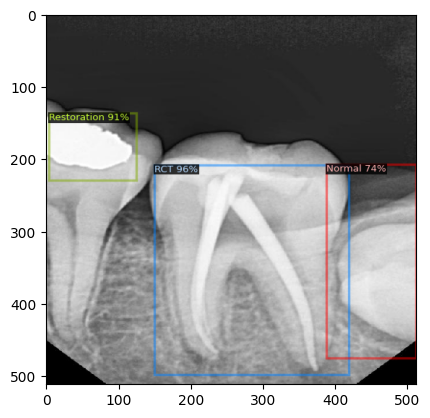

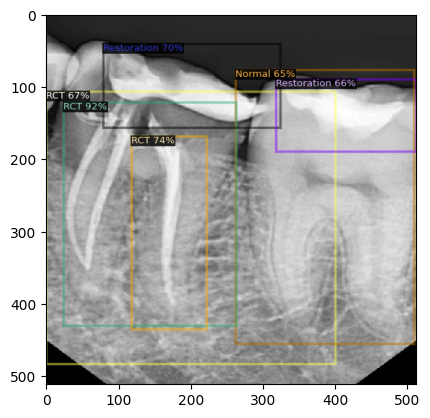

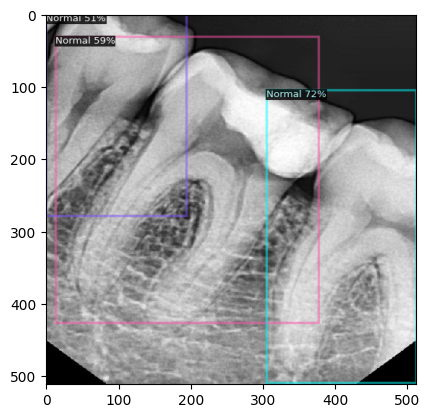

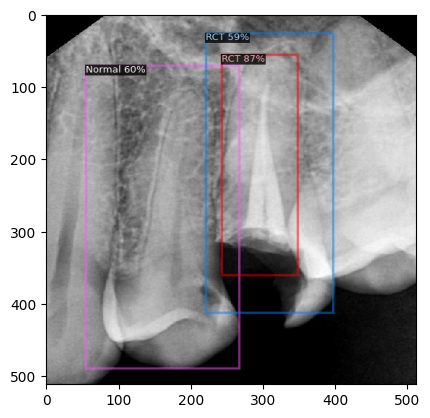

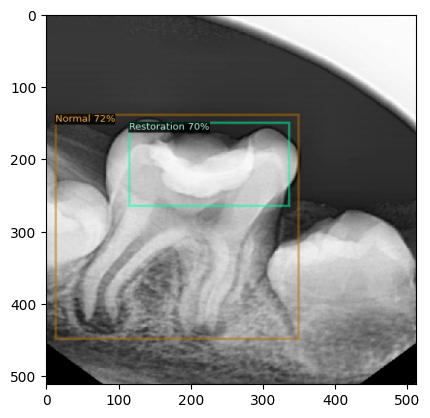

In [26]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")


from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob("/kaggle/working/dental-annotation-16/test/*jpg")[:5]:
    im = cv2.imread(imageName)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()
    print("\n")

In [27]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import matplotlib.pyplot as plt

[03/27 12:50:09 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /kaggle/working/output/model_final.pth ...
Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9561, 0.9084, 0.7353], device='cuda:0')


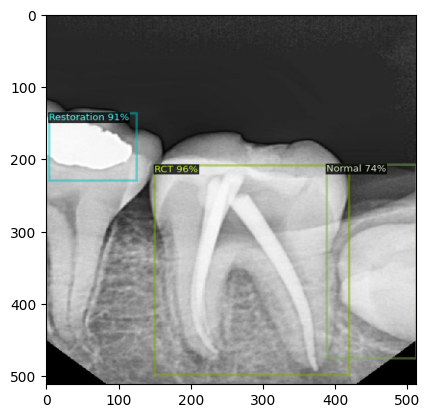



Classes : 
 tensor([8, 8, 9, 8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9152, 0.7431, 0.7033, 0.6695, 0.6642, 0.6490], device='cuda:0')


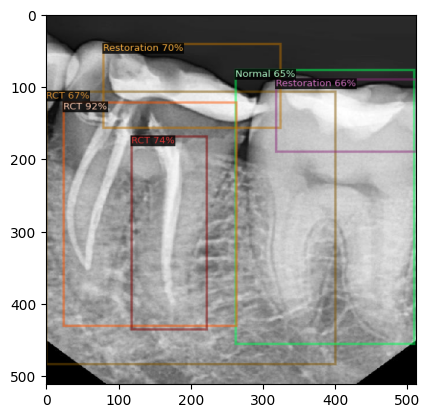



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7175], device='cuda:0')


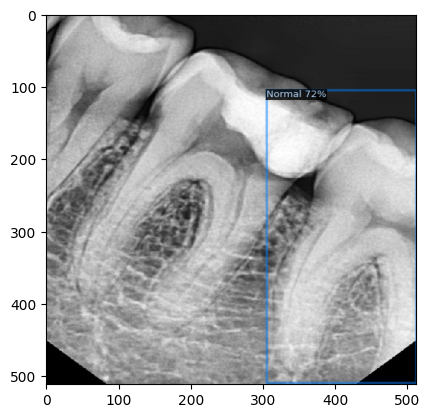



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.8670], device='cuda:0')


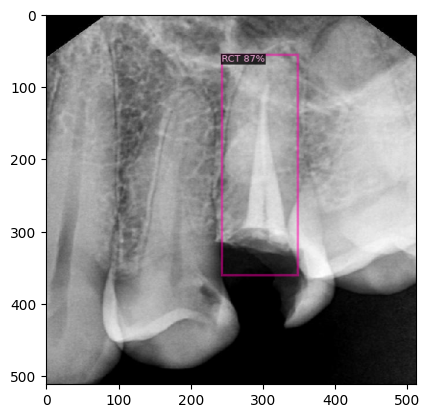



Classes : 
 tensor([5, 9], device='cuda:0')
Scores : 
 tensor([0.7208, 0.6991], device='cuda:0')


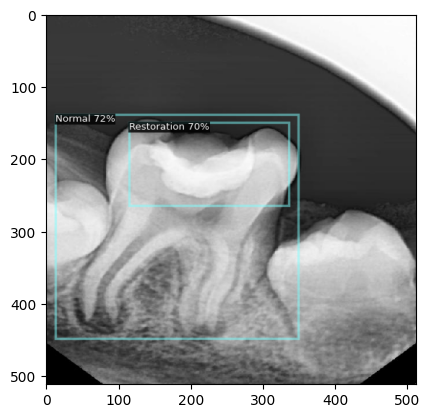



Classes : 
 tensor([5, 5, 5], device='cuda:0')
Scores : 
 tensor([0.7902, 0.7287, 0.6769], device='cuda:0')


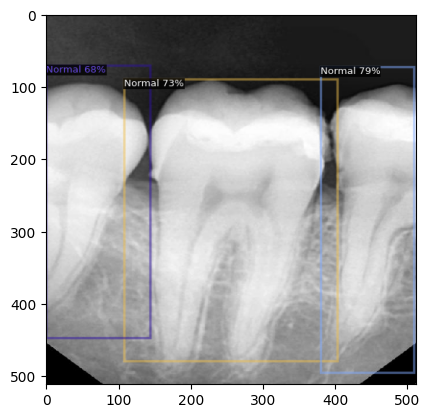



Classes : 
 tensor([8, 8, 5], device='cuda:0')
Scores : 
 tensor([0.9558, 0.7245, 0.6527], device='cuda:0')


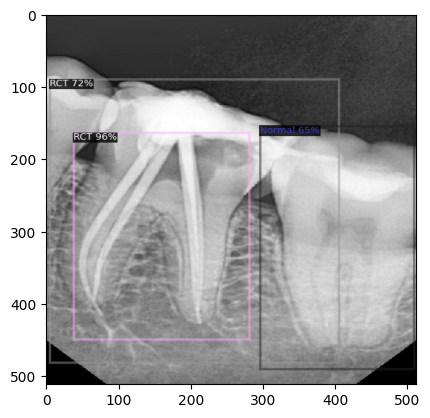



Classes : 
 tensor([8, 9, 5, 8], device='cuda:0')
Scores : 
 tensor([0.8098, 0.6912, 0.6757, 0.6657], device='cuda:0')


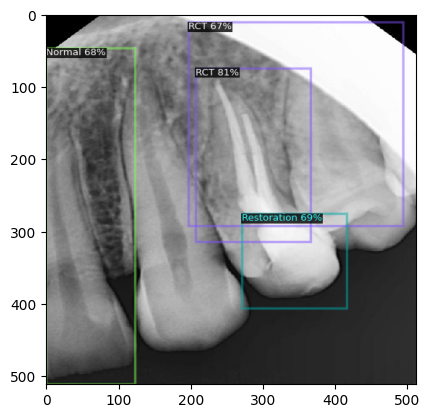



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.8015, 0.6533], device='cuda:0')


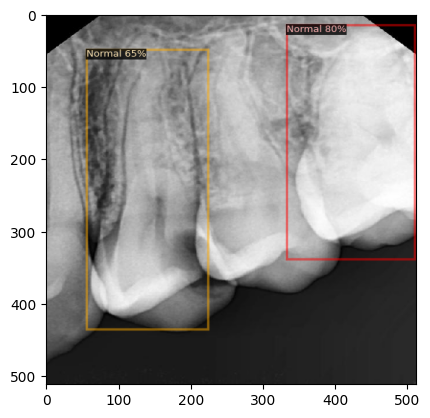



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.6367, 0.6341], device='cuda:0')


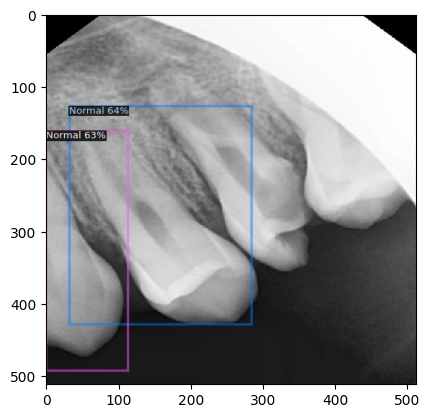



Classes : 
 tensor([5, 8], device='cuda:0')
Scores : 
 tensor([0.7416, 0.6936], device='cuda:0')


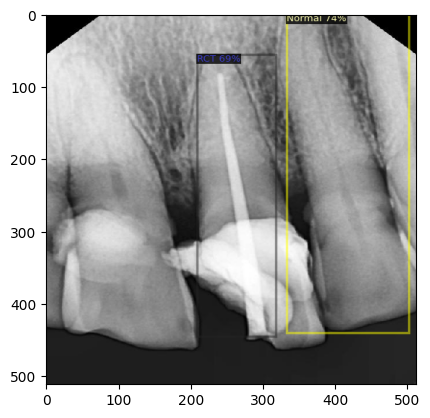



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9418], device='cuda:0')


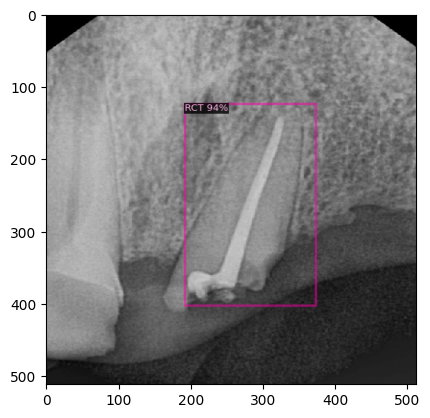



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.8495], device='cuda:0')


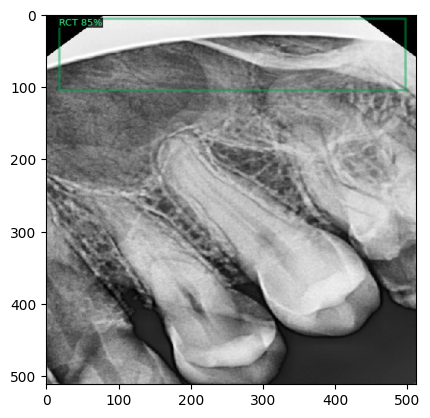



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.8861, 0.6899], device='cuda:0')


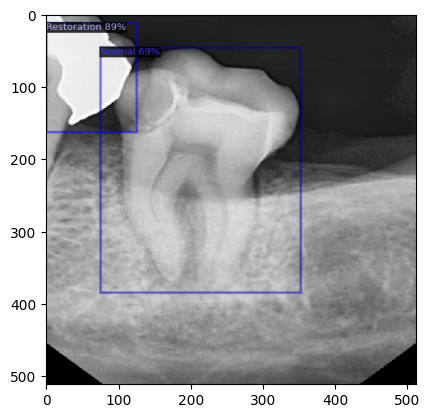



Classes : 
 tensor([4, 8], device='cuda:0')
Scores : 
 tensor([0.8254, 0.6531], device='cuda:0')


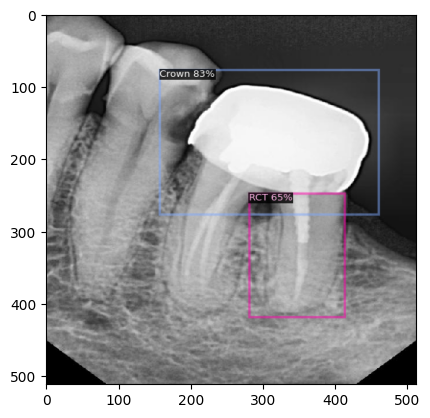



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7439, 0.6840], device='cuda:0')


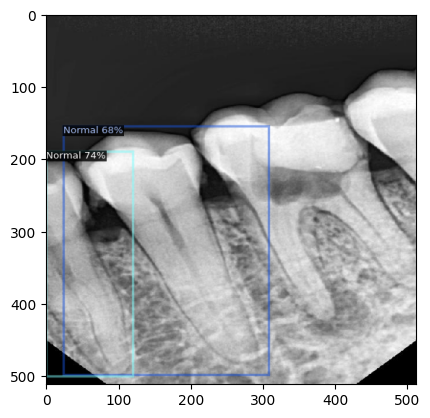



Classes : 
 tensor([5, 8, 5], device='cuda:0')
Scores : 
 tensor([0.7252, 0.7134, 0.6753], device='cuda:0')


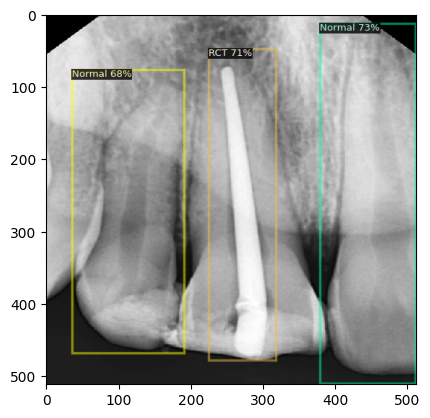



Classes : 
 tensor([9, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9075, 0.8096, 0.6169], device='cuda:0')


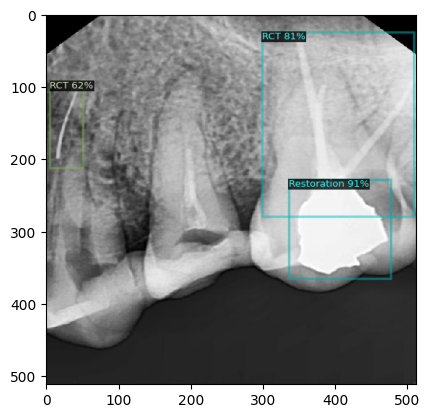



Classes : 
 tensor([8, 8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9273, 0.8983, 0.6143, 0.6054], device='cuda:0')


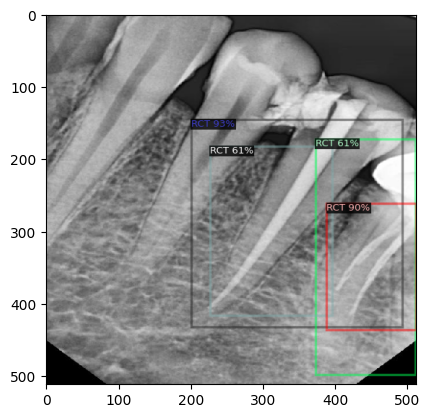



Classes : 
 tensor([8, 5, 5, 9], device='cuda:0')
Scores : 
 tensor([0.8807, 0.7905, 0.7719, 0.7112], device='cuda:0')


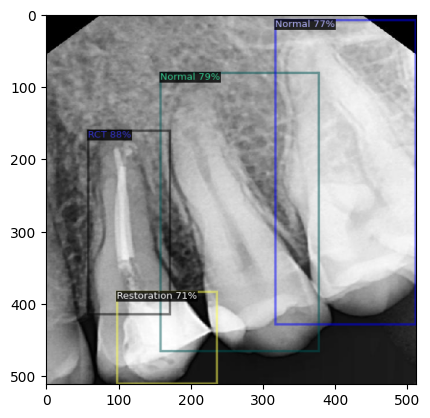



Classes : 
 tensor([4], device='cuda:0')
Scores : 
 tensor([0.7861], device='cuda:0')


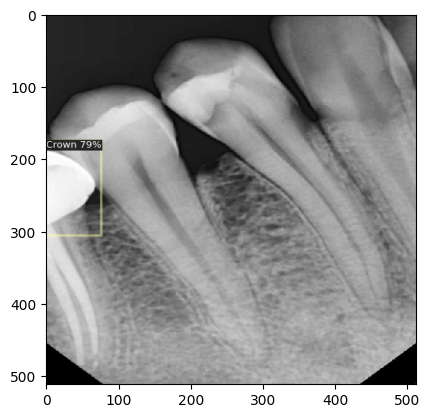



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.8057], device='cuda:0')


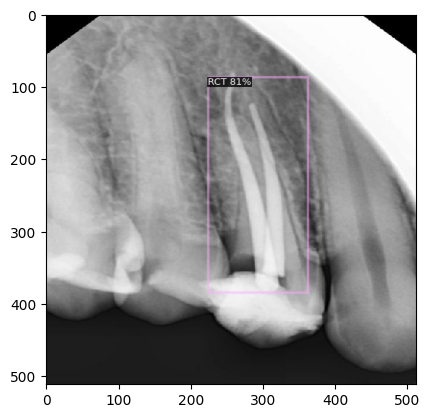



Classes : 
 tensor([8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.8346, 0.7847, 0.6542], device='cuda:0')


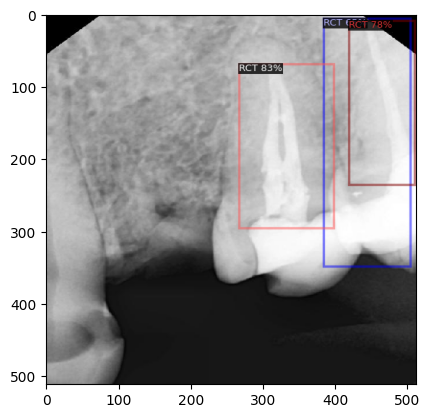



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6888], device='cuda:0')


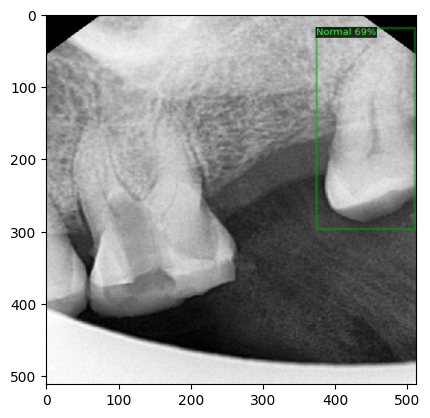



Classes : 
 tensor([8, 5], device='cuda:0')
Scores : 
 tensor([0.6477, 0.6226], device='cuda:0')


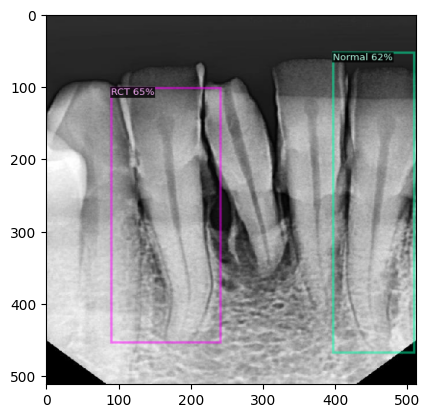



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9522], device='cuda:0')


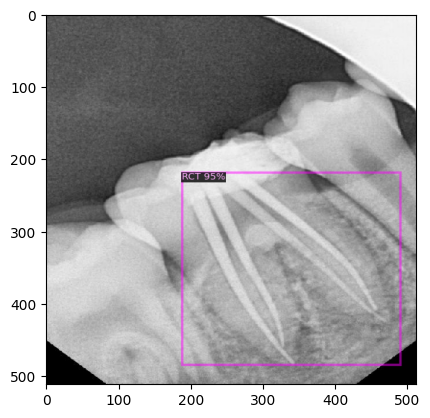



Classes : 
 tensor([8, 8, 9, 8], device='cuda:0')
Scores : 
 tensor([0.9390, 0.8677, 0.8486, 0.6128], device='cuda:0')


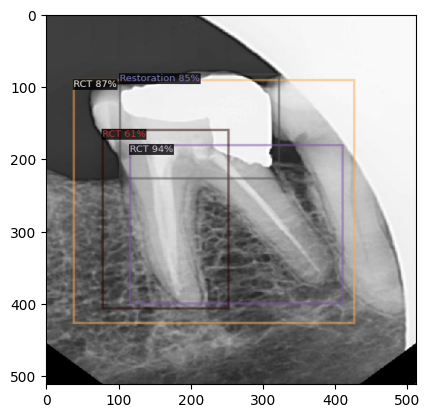



Classes : 
 tensor([8, 8, 9, 9, 8], device='cuda:0')
Scores : 
 tensor([0.9385, 0.9004, 0.7832, 0.7067, 0.6658], device='cuda:0')


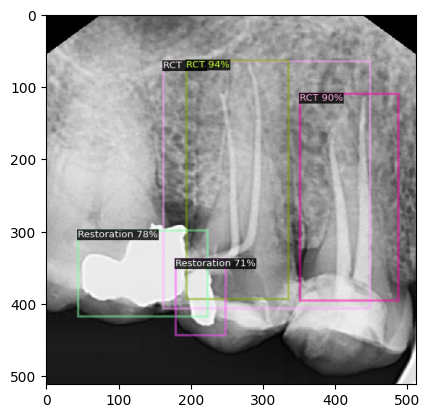



Classes : 
 tensor([8, 9], device='cuda:0')
Scores : 
 tensor([0.9196, 0.7662], device='cuda:0')


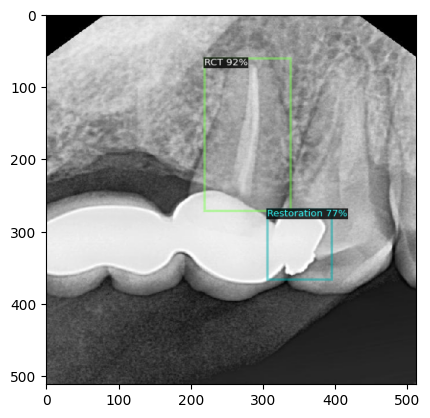



Classes : 
 tensor([], device='cuda:0', dtype=torch.int64)
Scores : 
 tensor([], device='cuda:0')


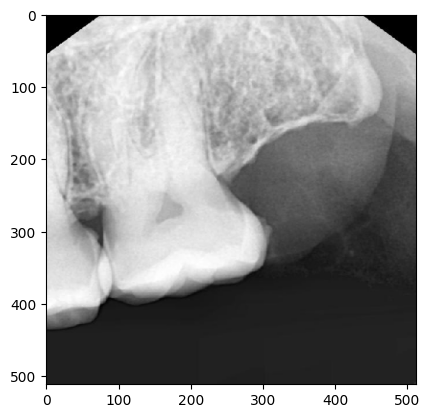



Classes : 
 tensor([8, 5], device='cuda:0')
Scores : 
 tensor([0.9362, 0.6687], device='cuda:0')


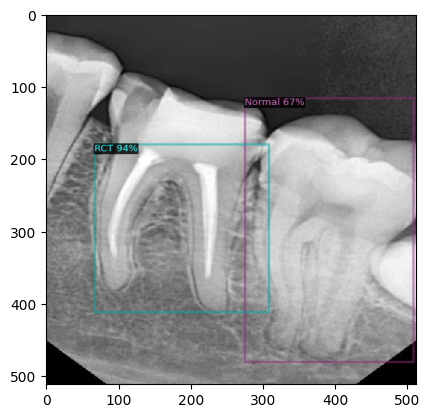



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7950, 0.6046], device='cuda:0')


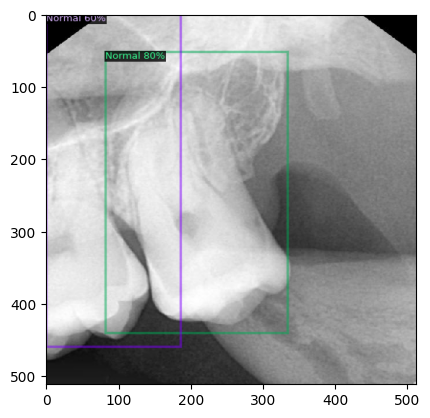



Classes : 
 tensor([8, 5, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9293, 0.7625, 0.6542, 0.6310], device='cuda:0')


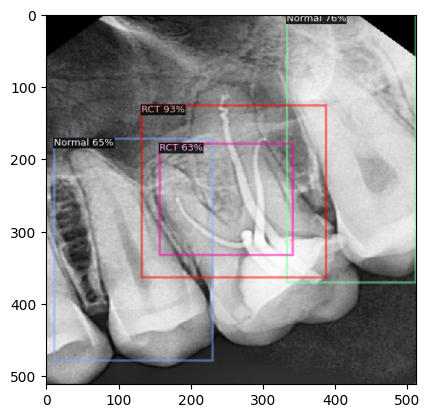



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7120, 0.6076], device='cuda:0')


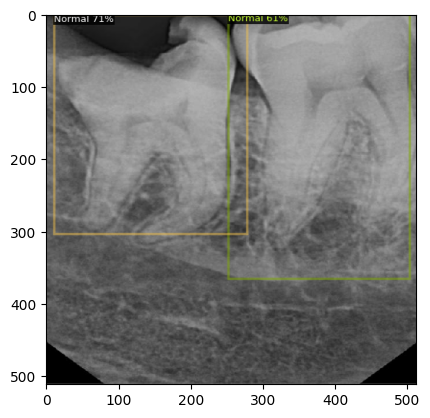



Classes : 
 tensor([9, 5, 5], device='cuda:0')
Scores : 
 tensor([0.8573, 0.6673, 0.6306], device='cuda:0')


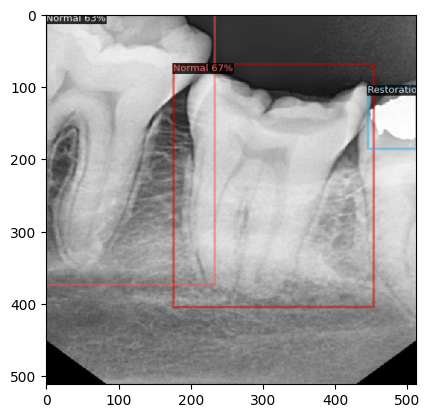



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.8144], device='cuda:0')


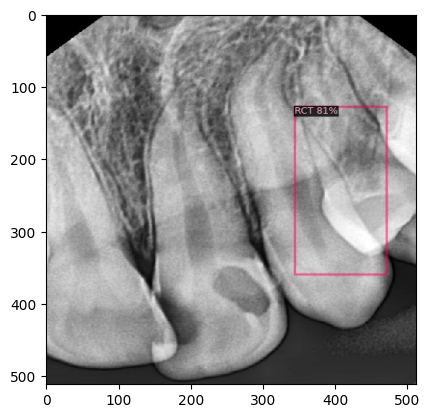



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7865, 0.6897], device='cuda:0')


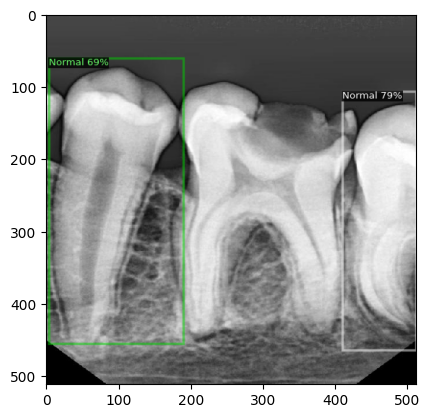



Classes : 
 tensor([9, 4], device='cuda:0')
Scores : 
 tensor([0.6539, 0.6433], device='cuda:0')


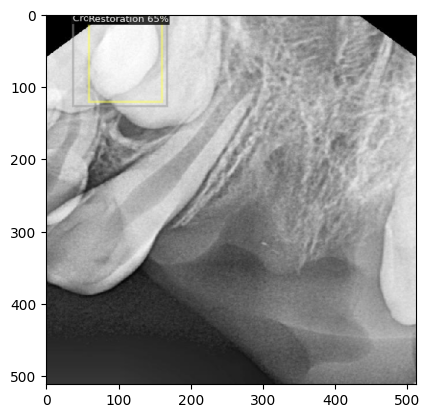



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7827, 0.7214], device='cuda:0')


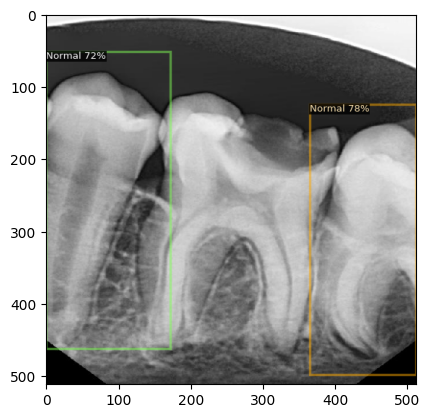



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7190], device='cuda:0')


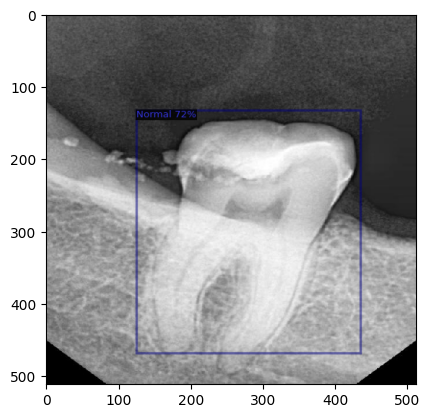



Classes : 
 tensor([8, 5, 5, 8, 9, 8], device='cuda:0')
Scores : 
 tensor([0.8934, 0.7622, 0.7361, 0.6514, 0.6259, 0.6210], device='cuda:0')


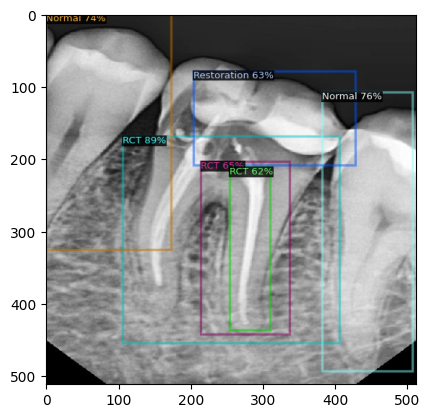



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9566, 0.9133, 0.7549], device='cuda:0')


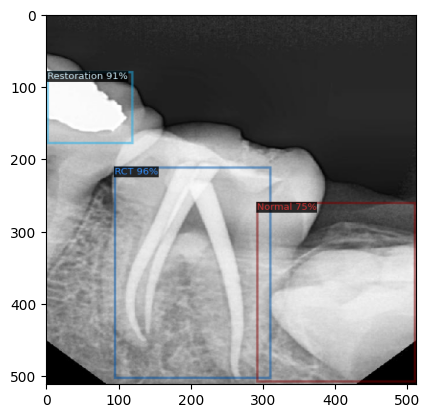



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.7676, 0.7484], device='cuda:0')


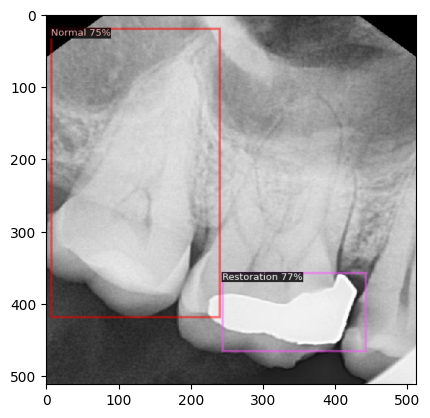



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7185, 0.6624], device='cuda:0')


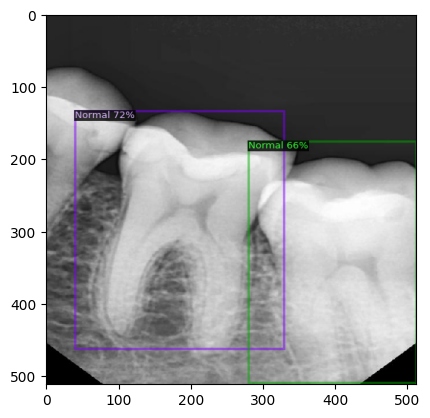



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.8168, 0.7007], device='cuda:0')


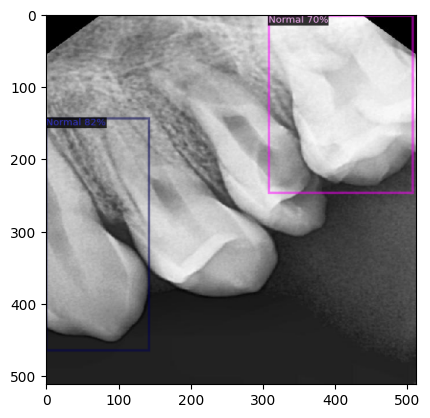



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7223], device='cuda:0')


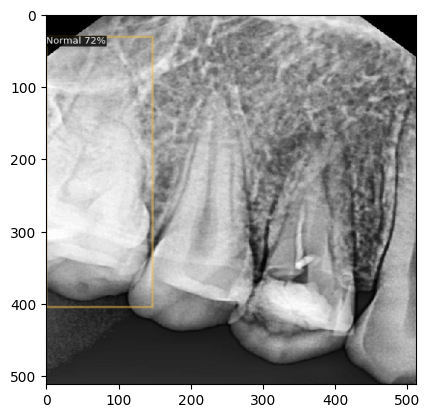



Classes : 
 tensor([8, 5, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9194, 0.6701, 0.6639, 0.6515], device='cuda:0')


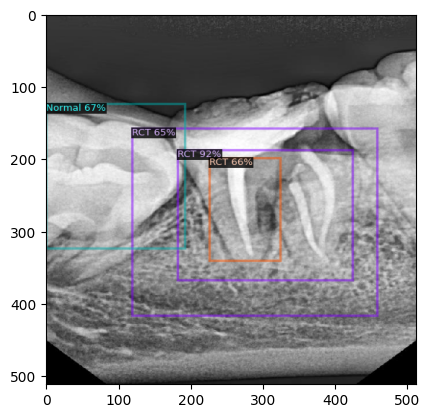



Classes : 
 tensor([8, 8, 9, 8, 9], device='cuda:0')
Scores : 
 tensor([0.9326, 0.9296, 0.8877, 0.6997, 0.6279], device='cuda:0')


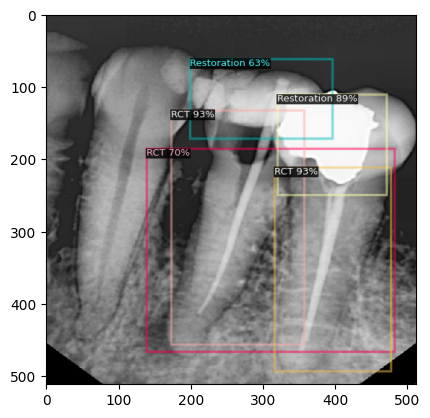



Classes : 
 tensor([8, 8], device='cuda:0')
Scores : 
 tensor([0.9443, 0.6498], device='cuda:0')


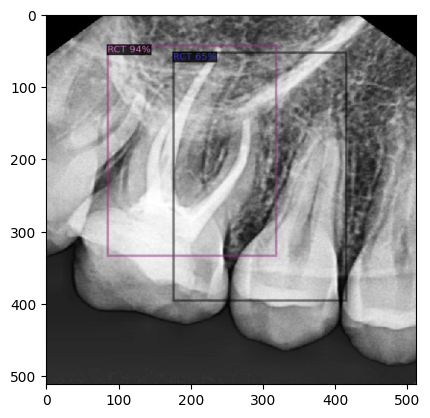



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7386, 0.7085], device='cuda:0')


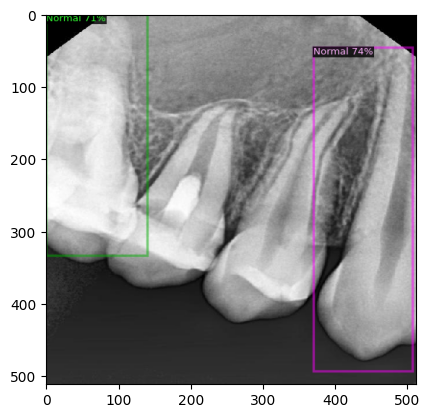



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6962], device='cuda:0')


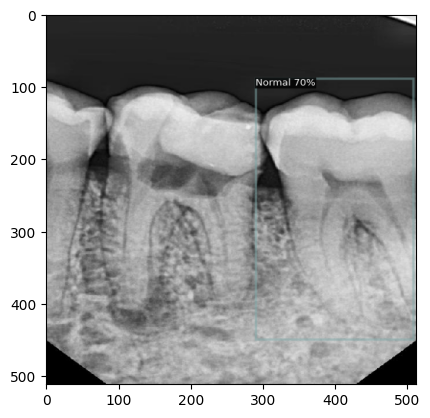



Classes : 
 tensor([9], device='cuda:0')
Scores : 
 tensor([0.8404], device='cuda:0')


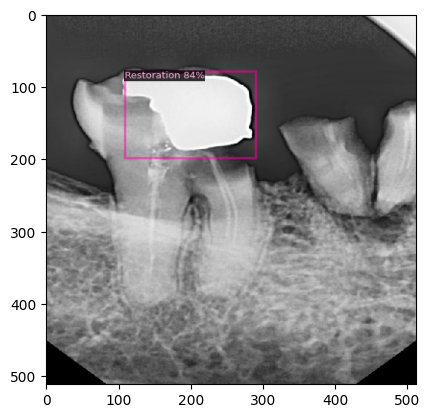



Classes : 
 tensor([], device='cuda:0', dtype=torch.int64)
Scores : 
 tensor([], device='cuda:0')


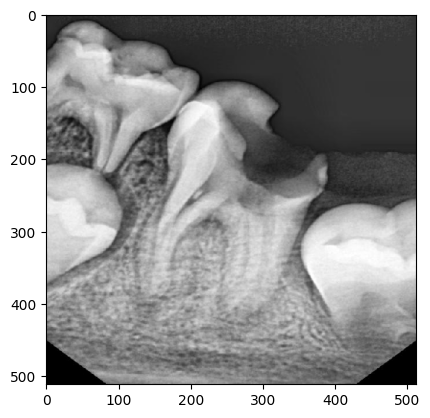



Classes : 
 tensor([8, 8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9463, 0.9259, 0.7817, 0.7630], device='cuda:0')


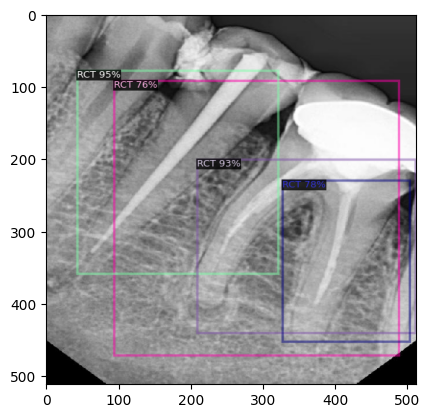



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7810, 0.7763], device='cuda:0')


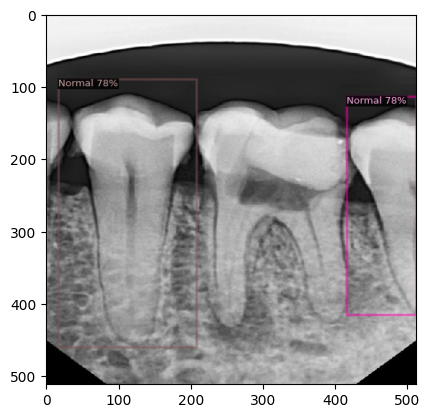



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6822], device='cuda:0')


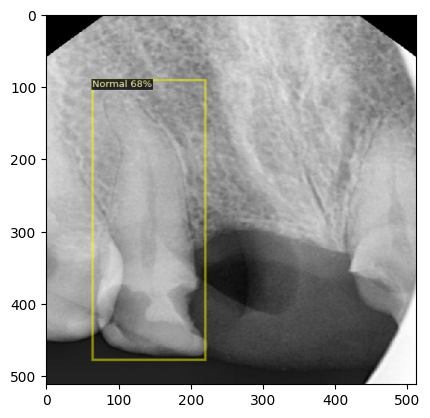



Classes : 
 tensor([8, 8, 5, 5, 9], device='cuda:0')
Scores : 
 tensor([0.8430, 0.7427, 0.6998, 0.6945, 0.6414], device='cuda:0')


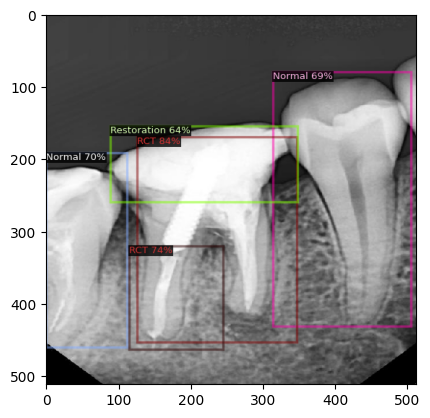



Classes : 
 tensor([8, 8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9664, 0.7546, 0.7038, 0.6715], device='cuda:0')


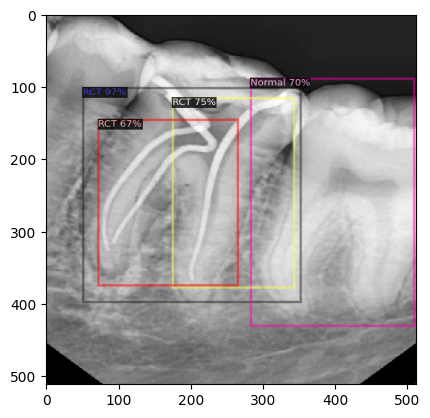



Classes : 
 tensor([8, 8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.8884, 0.8751, 0.7961, 0.7624], device='cuda:0')


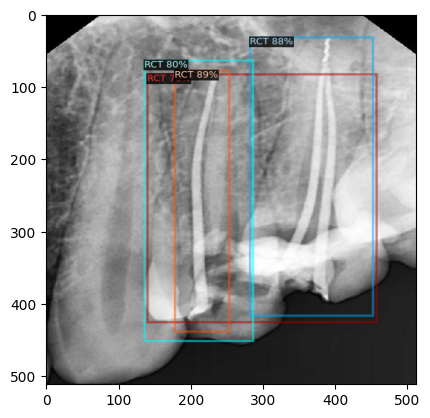



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9064], device='cuda:0')


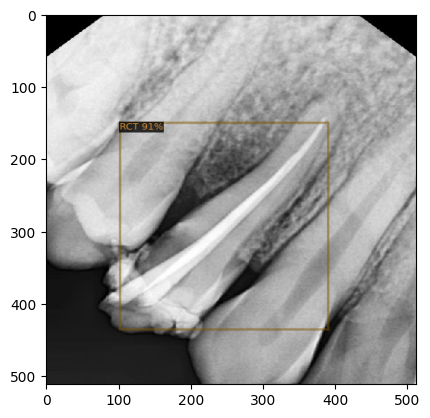



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.8145, 0.7193], device='cuda:0')


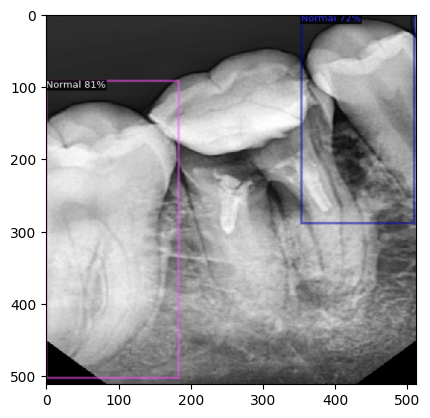



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7331], device='cuda:0')


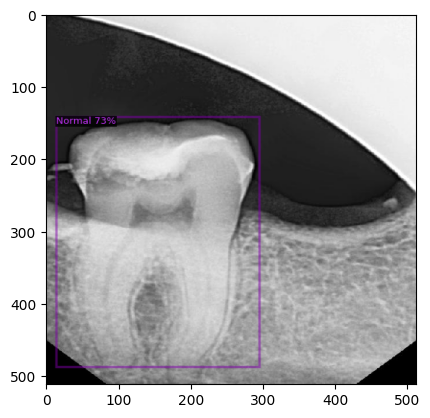



Classes : 
 tensor([8, 4, 5, 5], device='cuda:0')
Scores : 
 tensor([0.9485, 0.8867, 0.7943, 0.6558], device='cuda:0')


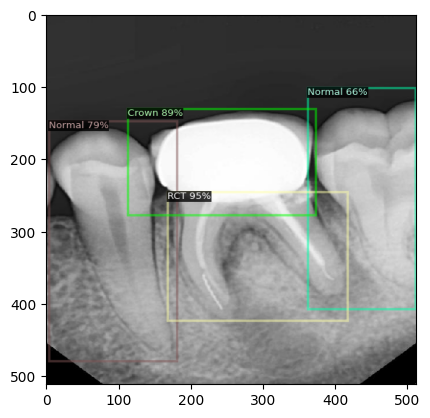



Classes : 
 tensor([9, 8, 5], device='cuda:0')
Scores : 
 tensor([0.9012, 0.8590, 0.6565], device='cuda:0')


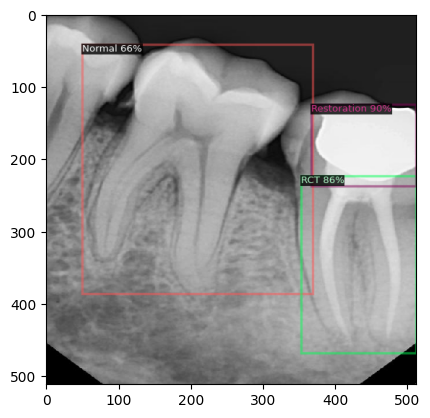



Classes : 
 tensor([8, 4, 8, 5], device='cuda:0')
Scores : 
 tensor([0.9172, 0.8774, 0.6858, 0.6078], device='cuda:0')


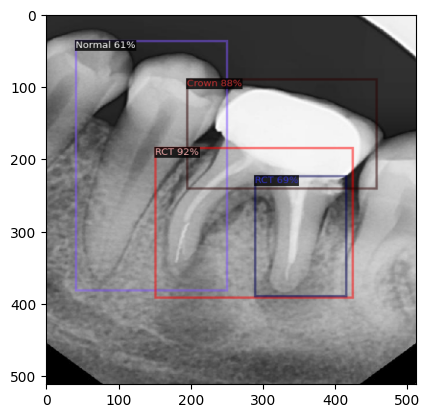



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.7996, 0.6616, 0.6285], device='cuda:0')


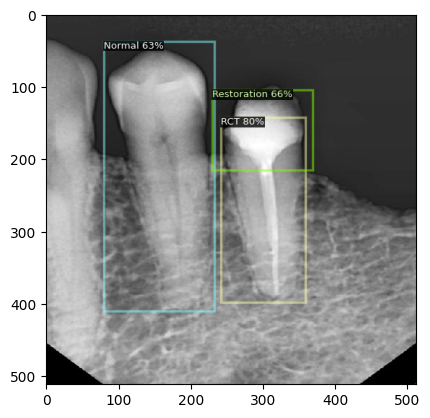



Classes : 
 tensor([5, 5, 9], device='cuda:0')
Scores : 
 tensor([0.7268, 0.6457, 0.6013], device='cuda:0')


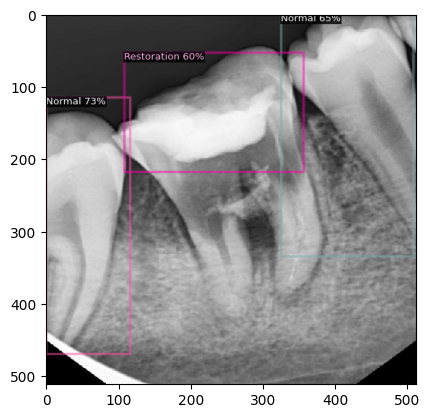



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7753, 0.6275], device='cuda:0')


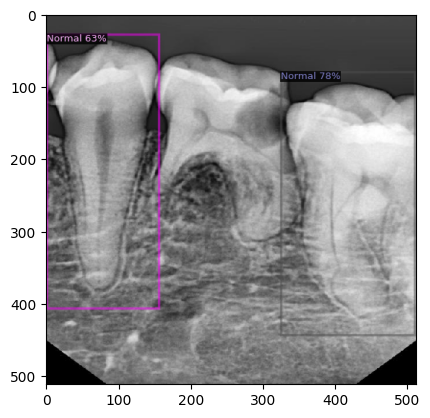



Classes : 
 tensor([8, 4, 5, 5], device='cuda:0')
Scores : 
 tensor([0.9348, 0.9201, 0.6827, 0.6056], device='cuda:0')


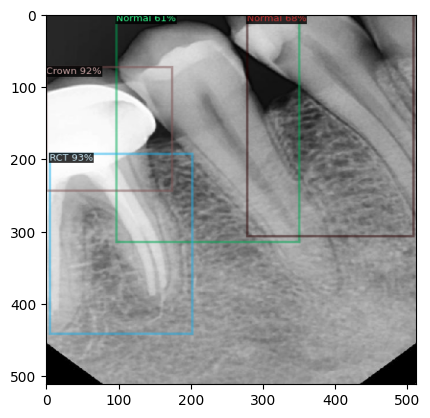



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9396, 0.8769, 0.7393], device='cuda:0')


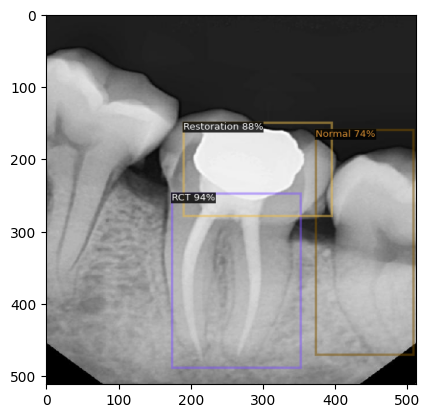



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.8253], device='cuda:0')


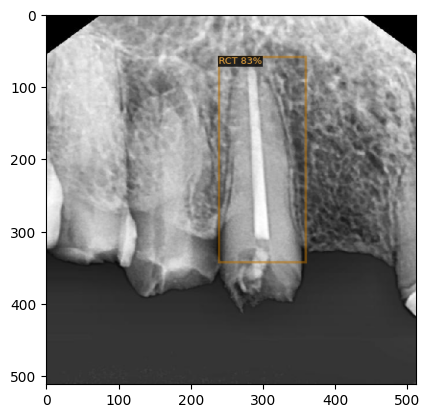



Classes : 
 tensor([8, 5], device='cuda:0')
Scores : 
 tensor([0.8925, 0.6451], device='cuda:0')


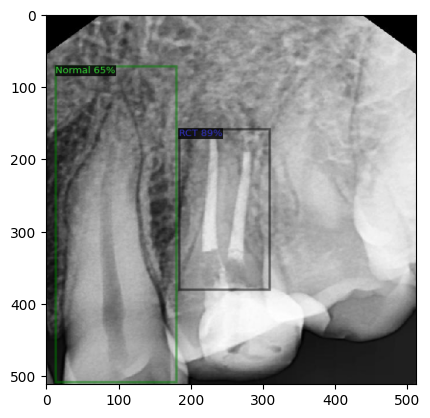



Classes : 
 tensor([8, 8, 8, 5, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9523, 0.9296, 0.7868, 0.7341, 0.6913, 0.6739], device='cuda:0')


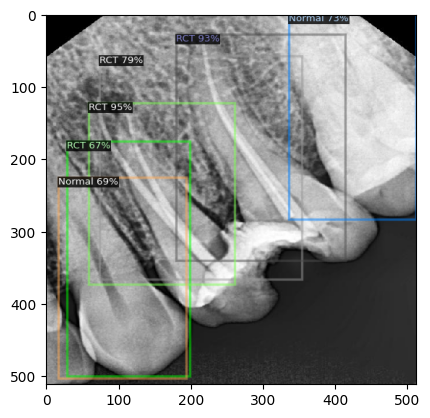



Classes : 
 tensor([8, 8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9105, 0.7903, 0.7359, 0.7076], device='cuda:0')


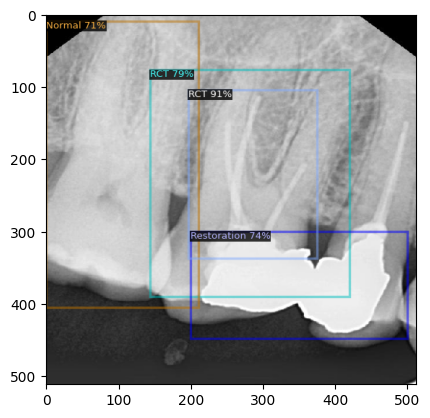



Classes : 
 tensor([8, 9, 9, 5, 8, 8], device='cuda:0')
Scores : 
 tensor([0.8595, 0.8251, 0.8183, 0.7745, 0.7098, 0.6086], device='cuda:0')


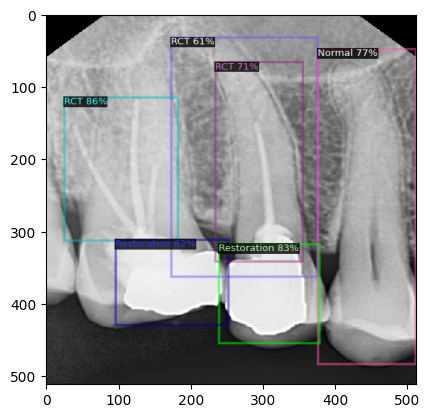



Classes : 
 tensor([5, 5, 5], device='cuda:0')
Scores : 
 tensor([0.7197, 0.6782, 0.6390], device='cuda:0')


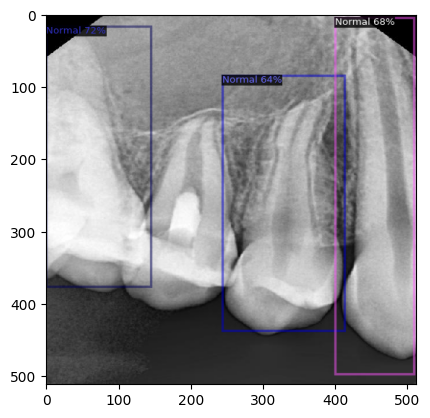



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.6656, 0.6542], device='cuda:0')


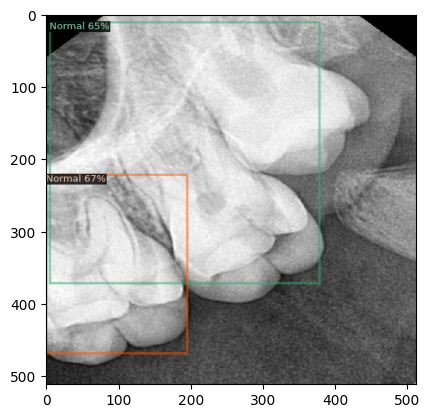



Classes : 
 tensor([8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9480, 0.7888, 0.7061], device='cuda:0')


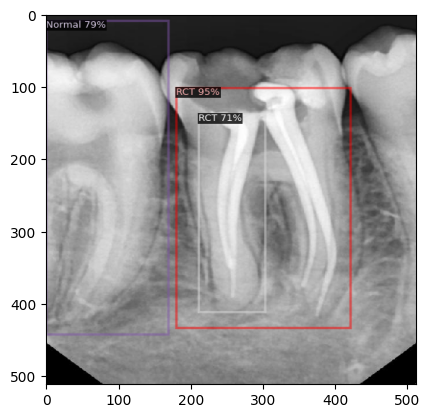



Classes : 
 tensor([9, 5, 5], device='cuda:0')
Scores : 
 tensor([0.8609, 0.6251, 0.6174], device='cuda:0')


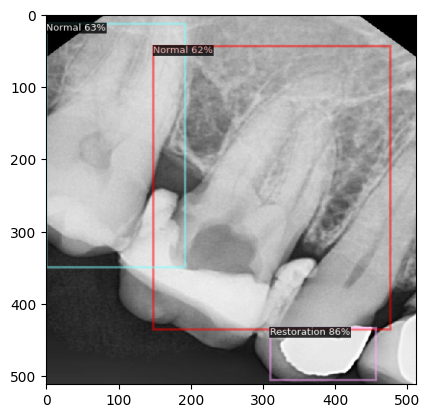



Classes : 
 tensor([], device='cuda:0', dtype=torch.int64)
Scores : 
 tensor([], device='cuda:0')


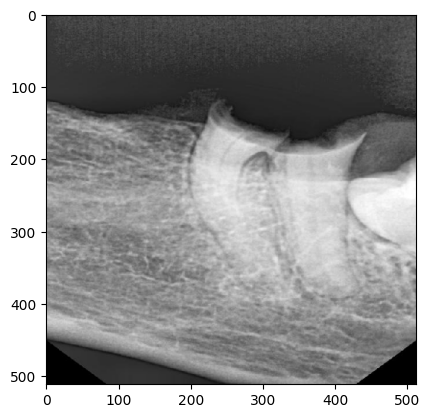



Classes : 
 tensor([8, 5, 9], device='cuda:0')
Scores : 
 tensor([0.7888, 0.7399, 0.6242], device='cuda:0')


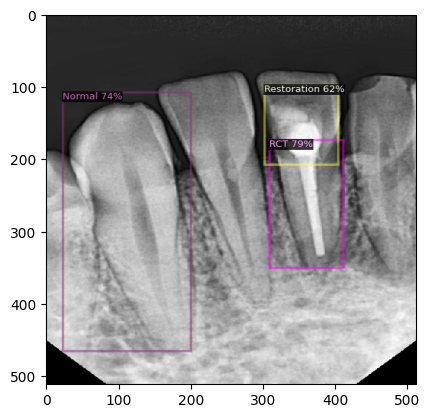



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6282], device='cuda:0')


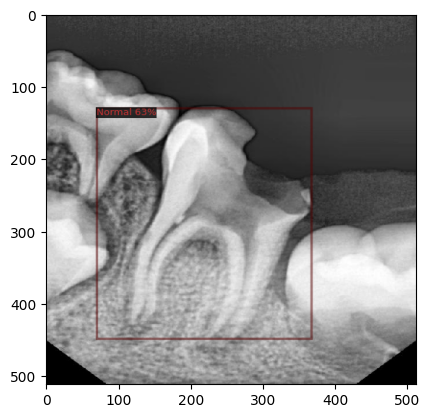



Classes : 
 tensor([8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9375, 0.8995, 0.8073], device='cuda:0')


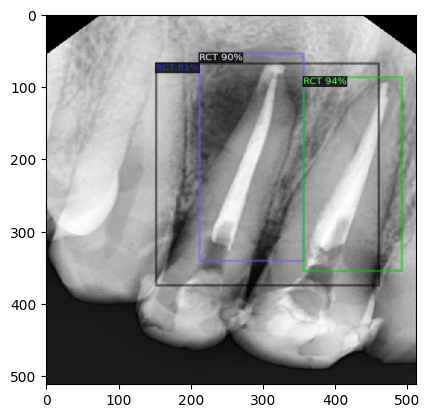



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7866, 0.7412], device='cuda:0')


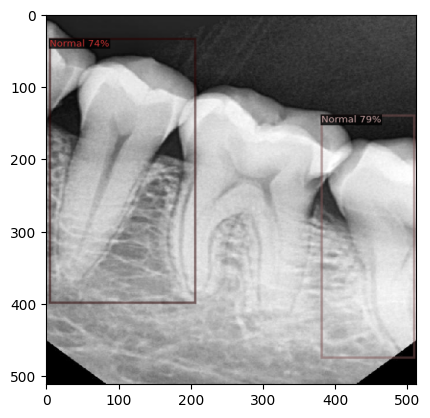



Classes : 
 tensor([4, 8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9669, 0.8816, 0.7730, 0.6989], device='cuda:0')


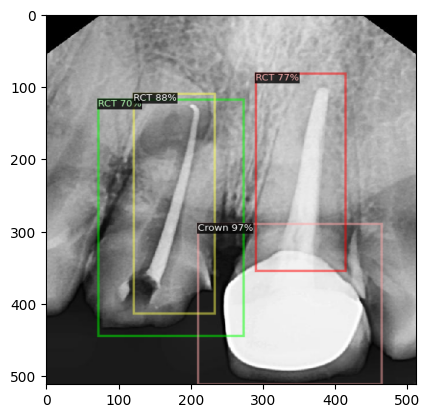



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9189], device='cuda:0')


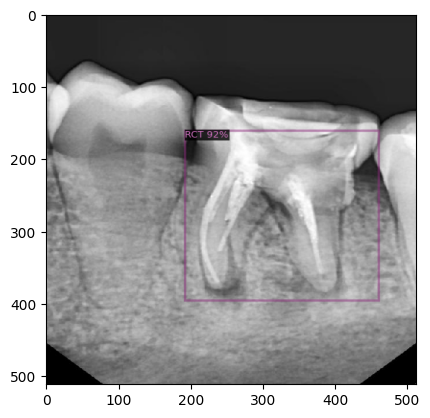



Classes : 
 tensor([8, 8, 8, 5], device='cuda:0')
Scores : 
 tensor([0.8664, 0.7915, 0.7732, 0.6760], device='cuda:0')


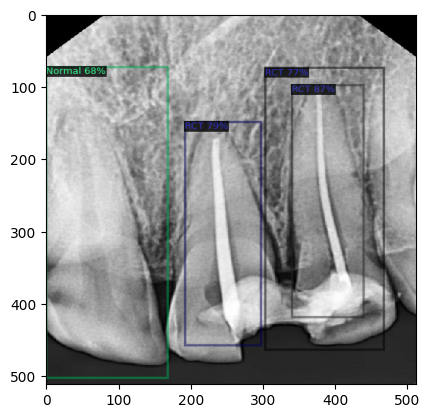



Classes : 
 tensor([8, 8, 8, 5], device='cuda:0')
Scores : 
 tensor([0.9416, 0.9133, 0.8521, 0.6732], device='cuda:0')


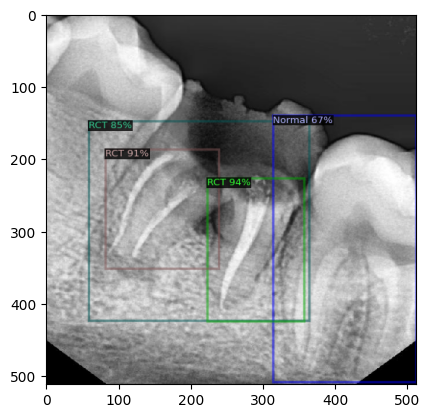



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9735], device='cuda:0')


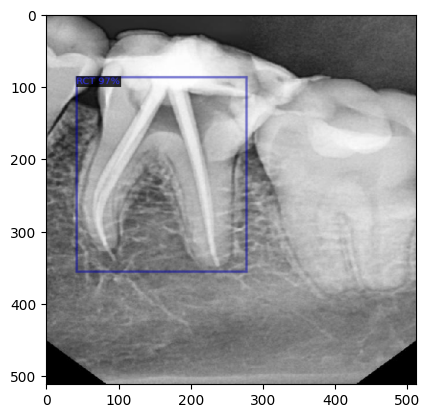



Classes : 
 tensor([4, 8, 8, 8, 9], device='cuda:0')
Scores : 
 tensor([0.9296, 0.9214, 0.7075, 0.7027, 0.6049], device='cuda:0')


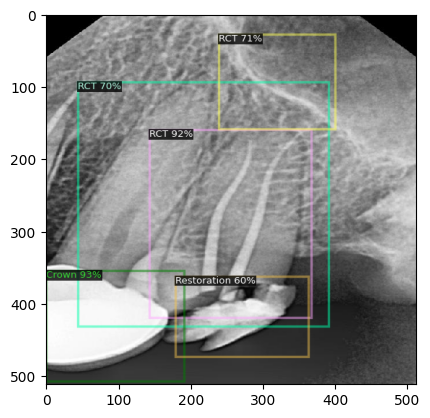



Classes : 
 tensor([8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9658, 0.6779, 0.6290], device='cuda:0')


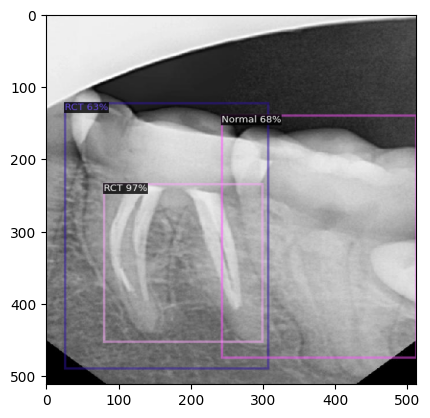



Classes : 
 tensor([4, 4, 8, 5, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9418, 0.8999, 0.8101, 0.7738, 0.6515, 0.6182], device='cuda:0')


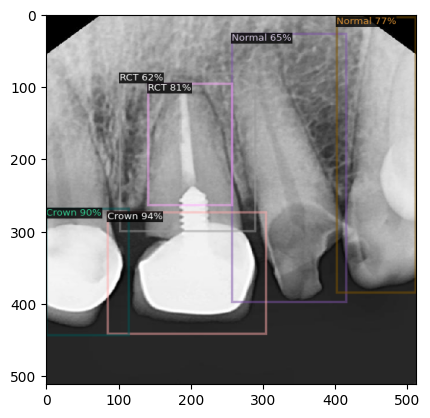



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6328], device='cuda:0')


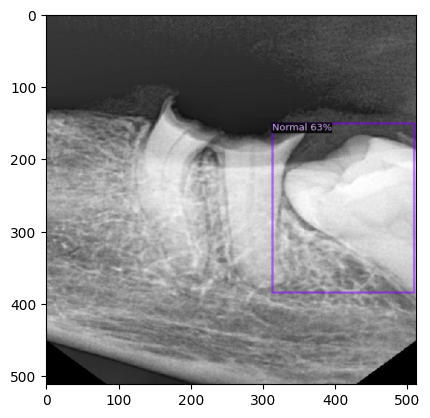



Classes : 
 tensor([5, 4], device='cuda:0')
Scores : 
 tensor([0.7117, 0.6835], device='cuda:0')


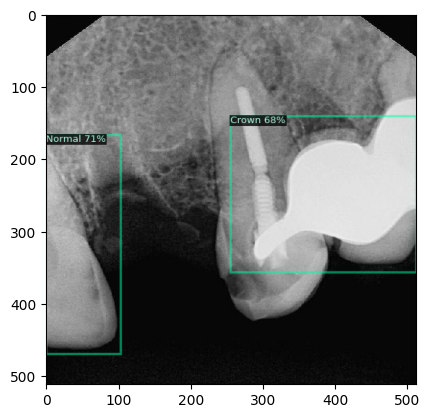



Classes : 
 tensor([8, 9], device='cuda:0')
Scores : 
 tensor([0.7770, 0.6552], device='cuda:0')


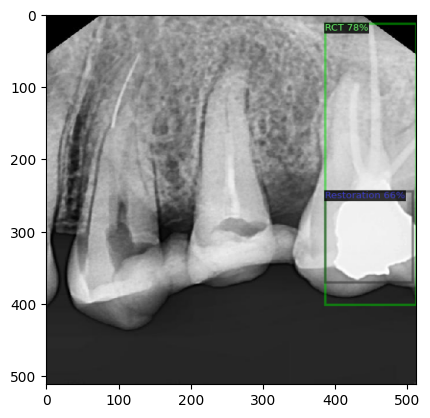



Classes : 
 tensor([9, 5, 5], device='cuda:0')
Scores : 
 tensor([0.8749, 0.7547, 0.6235], device='cuda:0')


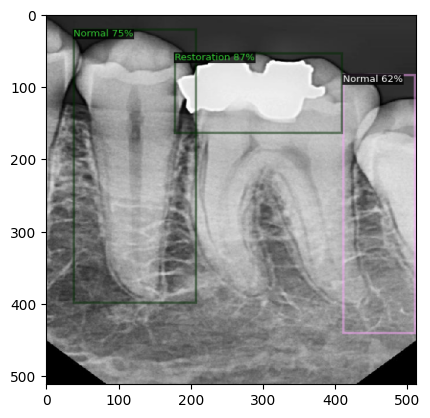



Classes : 
 tensor([8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.8255, 0.7211, 0.6123], device='cuda:0')


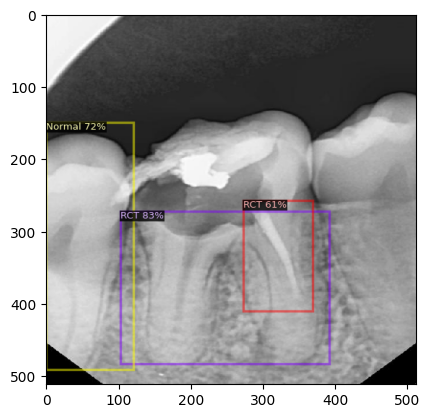



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7588], device='cuda:0')


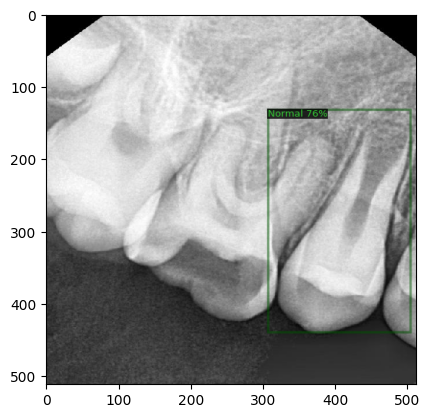



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7822, 0.6034], device='cuda:0')


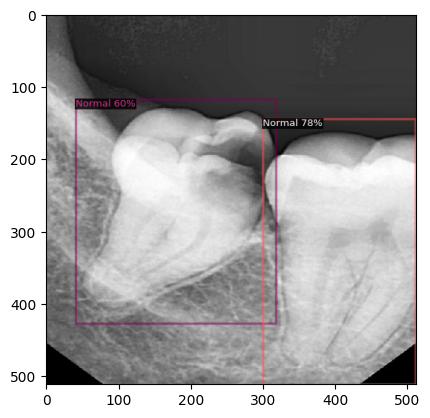



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.8672, 0.6987], device='cuda:0')


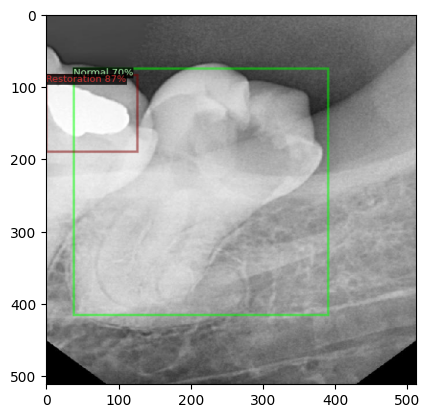



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.8857, 0.7684, 0.6912], device='cuda:0')


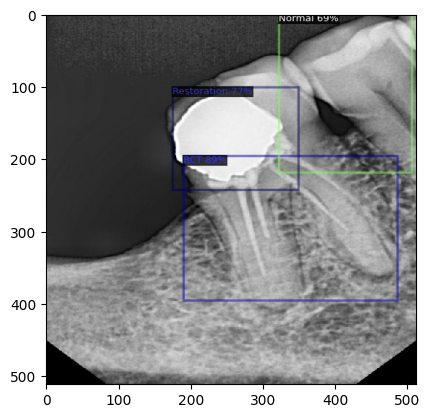



Classes : 
 tensor([8, 5], device='cuda:0')
Scores : 
 tensor([0.8460, 0.7938], device='cuda:0')


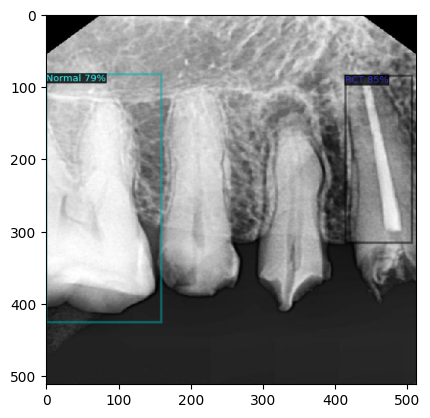



Classes : 
 tensor([4, 4, 8, 5, 5], device='cuda:0')
Scores : 
 tensor([0.9325, 0.8907, 0.8211, 0.7244, 0.6106], device='cuda:0')


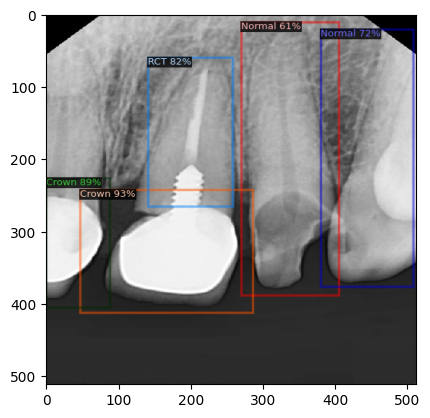



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7504, 0.6631], device='cuda:0')


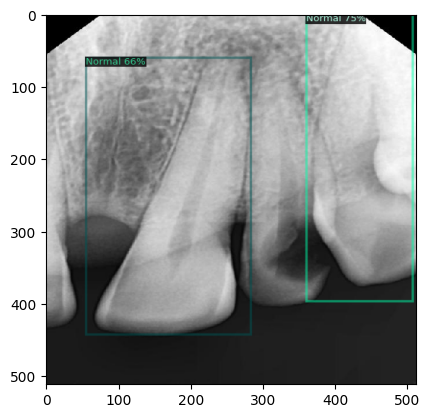



Classes : 
 tensor([4, 8, 5], device='cuda:0')
Scores : 
 tensor([0.7704, 0.7574, 0.6169], device='cuda:0')


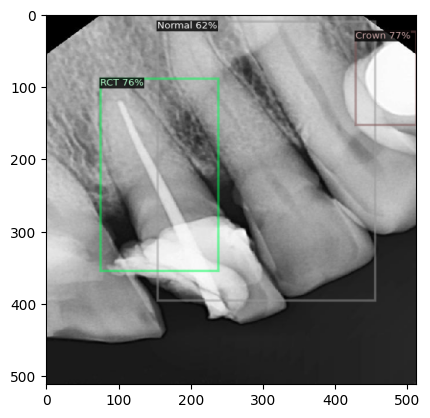



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.7539, 0.6716], device='cuda:0')


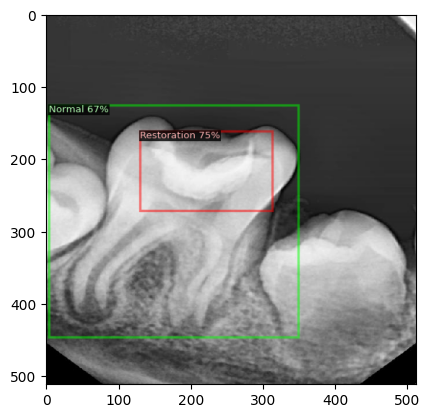



Classes : 
 tensor([8, 8], device='cuda:0')
Scores : 
 tensor([0.9510, 0.7044], device='cuda:0')


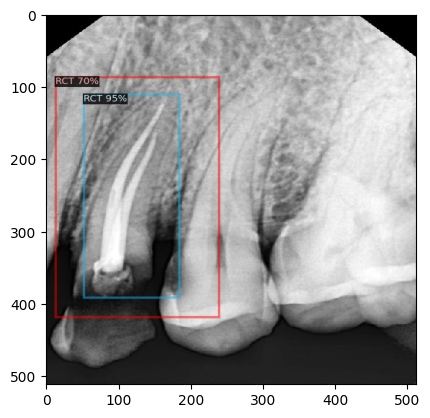



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9569], device='cuda:0')


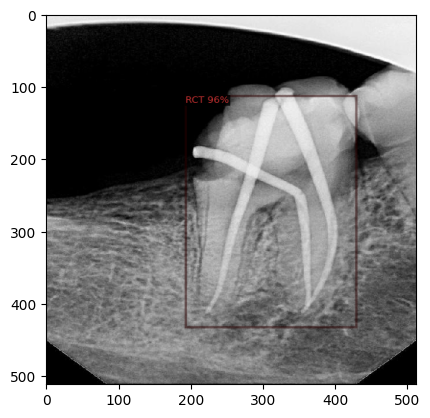



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.6781], device='cuda:0')


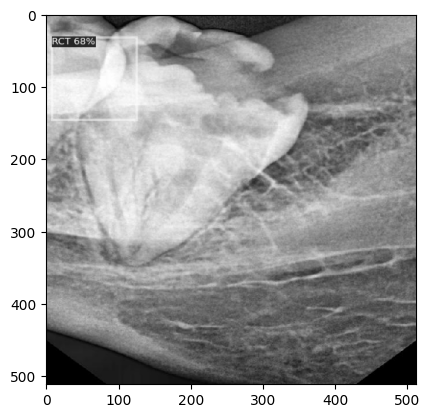



Classes : 
 tensor([8, 8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9236, 0.8242, 0.6791, 0.6331], device='cuda:0')


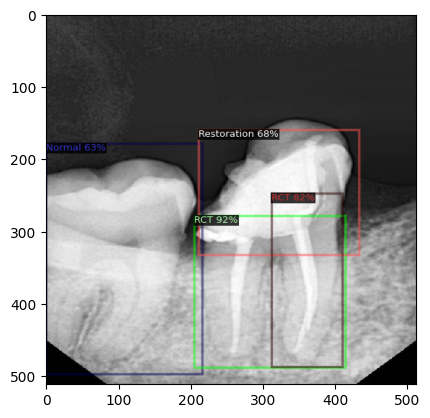



Classes : 
 tensor([9, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9251, 0.9108, 0.6260], device='cuda:0')


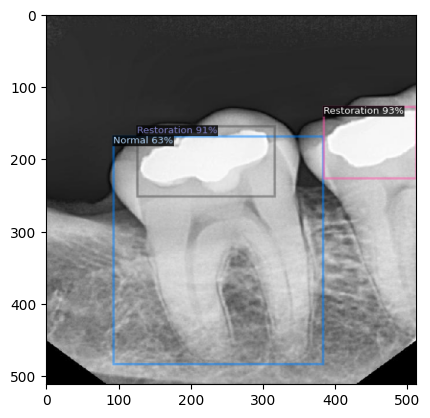



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7741, 0.6867], device='cuda:0')


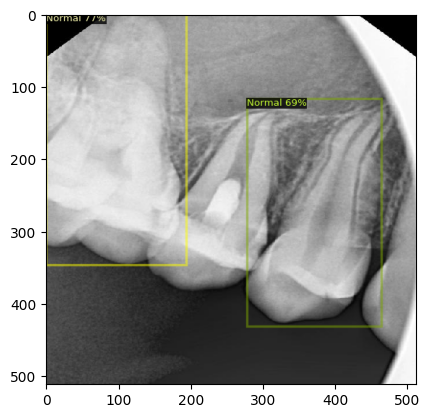



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.7016], device='cuda:0')


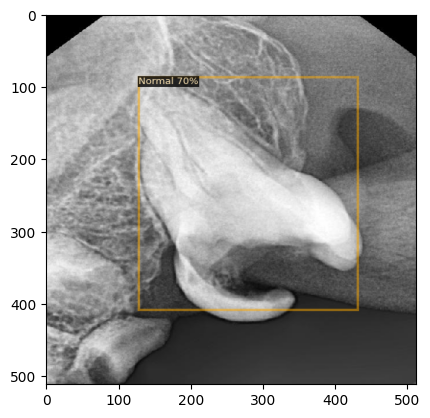



Classes : 
 tensor([9, 5, 9], device='cuda:0')
Scores : 
 tensor([0.8701, 0.7283, 0.6495], device='cuda:0')


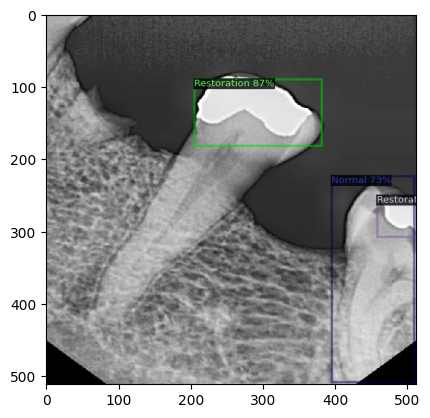



Classes : 
 tensor([8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.6336, 0.6274, 0.6161], device='cuda:0')


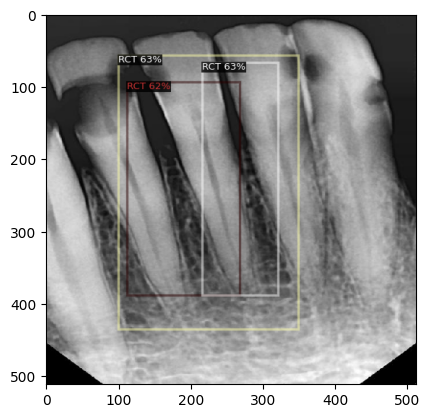



Classes : 
 tensor([4, 8, 5, 8, 8], device='cuda:0')
Scores : 
 tensor([0.7783, 0.7642, 0.7604, 0.7093, 0.6189], device='cuda:0')


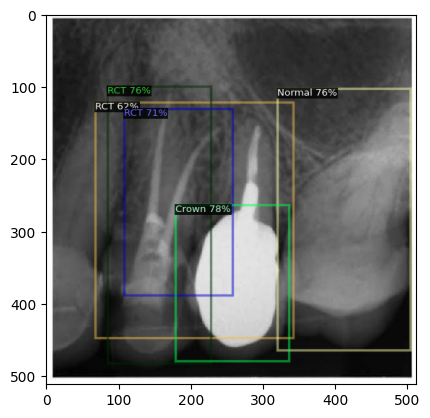



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.8134, 0.6742], device='cuda:0')


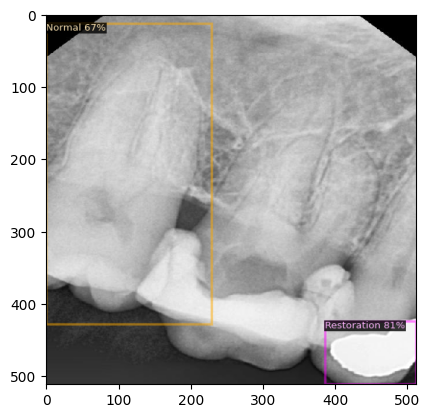



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.9435, 0.7238, 0.6658], device='cuda:0')


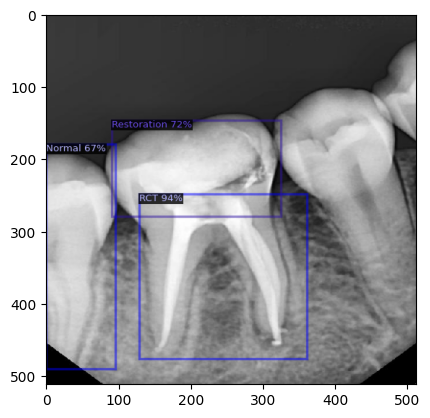



Classes : 
 tensor([8, 9], device='cuda:0')
Scores : 
 tensor([0.8969, 0.6194], device='cuda:0')


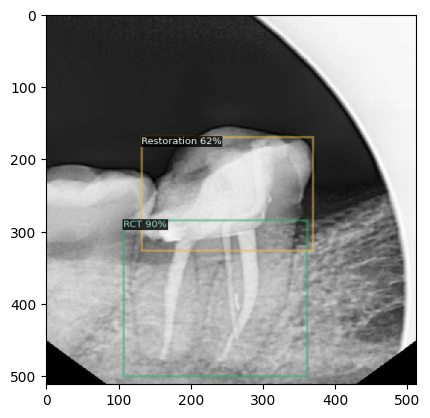



Classes : 
 tensor([4, 4, 8], device='cuda:0')
Scores : 
 tensor([0.9668, 0.9618, 0.8768], device='cuda:0')


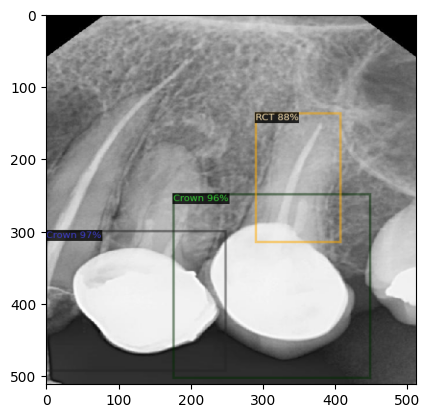



Classes : 
 tensor([9], device='cuda:0')
Scores : 
 tensor([0.8822], device='cuda:0')


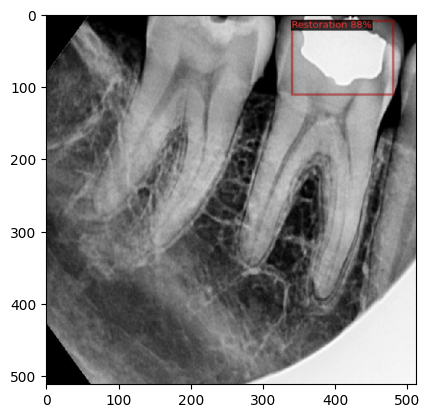



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.8359, 0.6986], device='cuda:0')


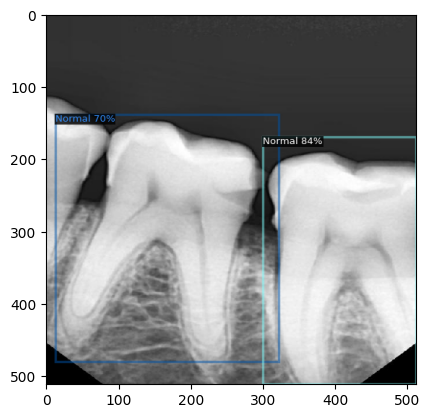



Classes : 
 tensor([8, 5], device='cuda:0')
Scores : 
 tensor([0.9106, 0.6345], device='cuda:0')


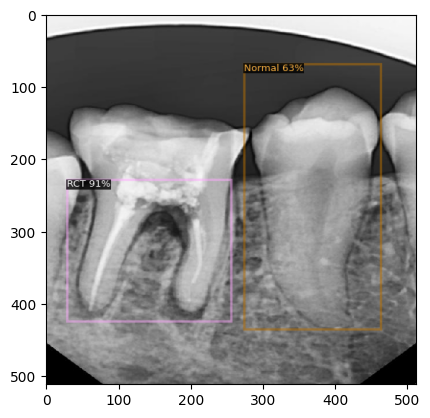



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.7391, 0.6047], device='cuda:0')


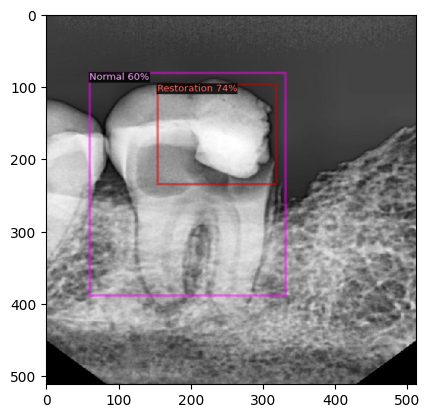



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.8243, 0.6653], device='cuda:0')


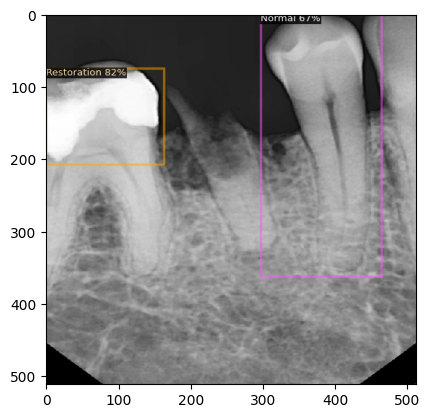



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7543, 0.6451], device='cuda:0')


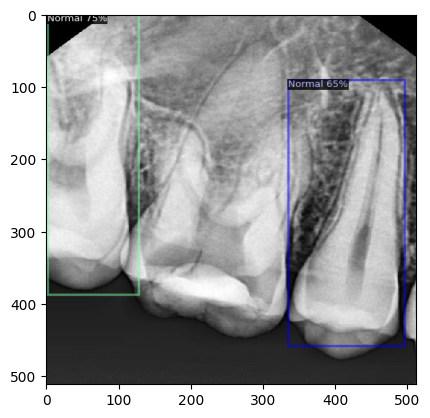



Classes : 
 tensor([8, 8], device='cuda:0')
Scores : 
 tensor([0.8381, 0.7551], device='cuda:0')


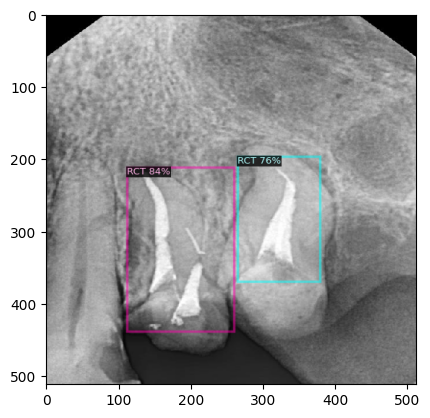



Classes : 
 tensor([9, 5], device='cuda:0')
Scores : 
 tensor([0.8398, 0.6826], device='cuda:0')


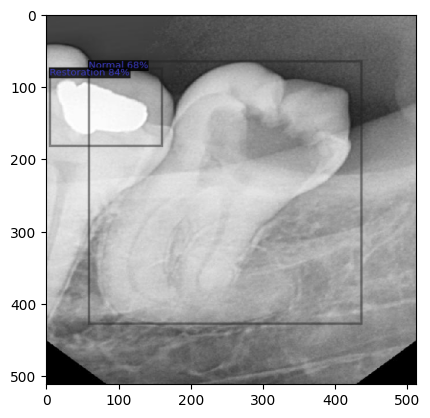



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.6964, 0.6612], device='cuda:0')


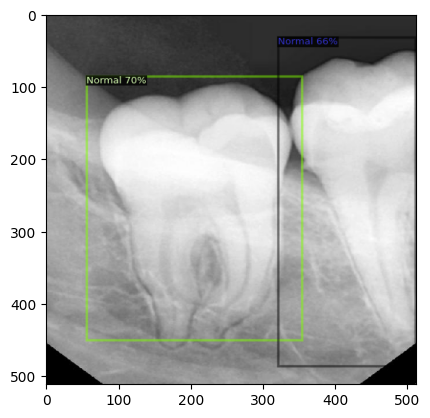



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.7776, 0.7722], device='cuda:0')


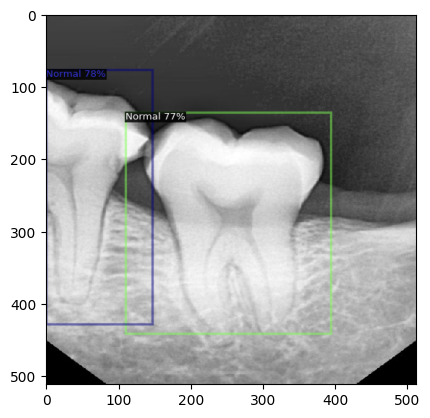



Classes : 
 tensor([8, 8], device='cuda:0')
Scores : 
 tensor([0.8082, 0.6144], device='cuda:0')


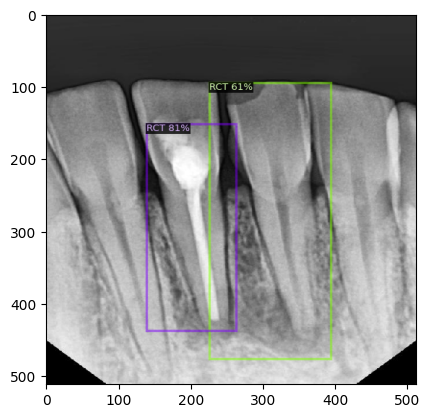



Classes : 
 tensor([8, 5, 8, 5], device='cuda:0')
Scores : 
 tensor([0.9234, 0.8086, 0.7444, 0.6250], device='cuda:0')


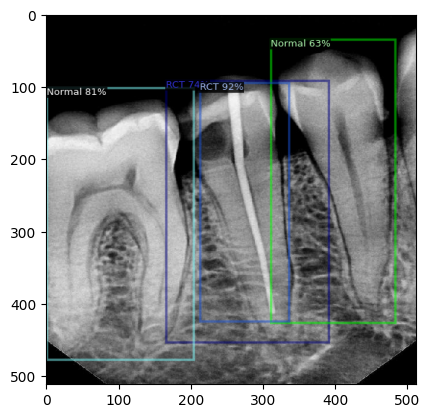



Classes : 
 tensor([8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.8032, 0.6450, 0.6393], device='cuda:0')


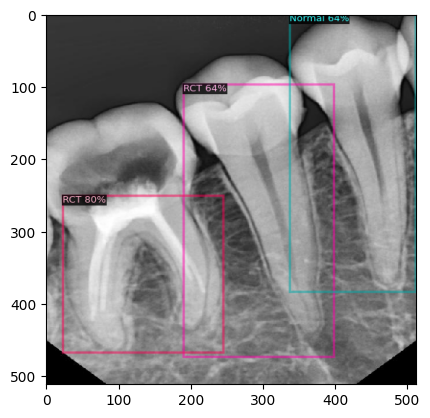



Classes : 
 tensor([9, 8], device='cuda:0')
Scores : 
 tensor([0.8852, 0.8325], device='cuda:0')


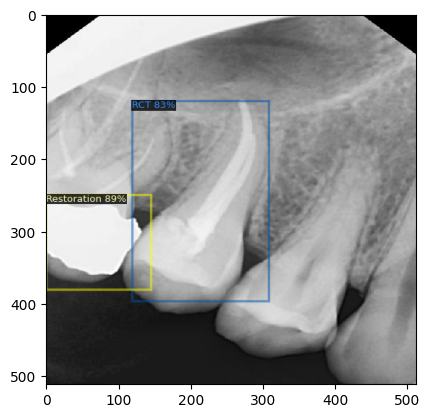



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9530], device='cuda:0')


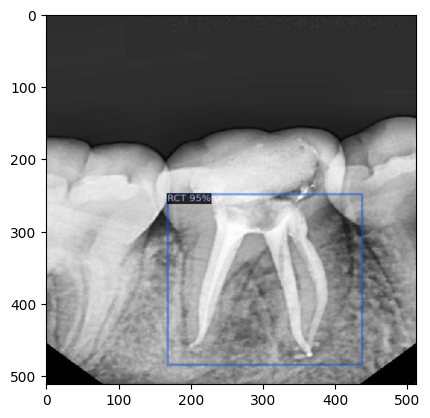



Classes : 
 tensor([8, 8], device='cuda:0')
Scores : 
 tensor([0.9120, 0.6474], device='cuda:0')


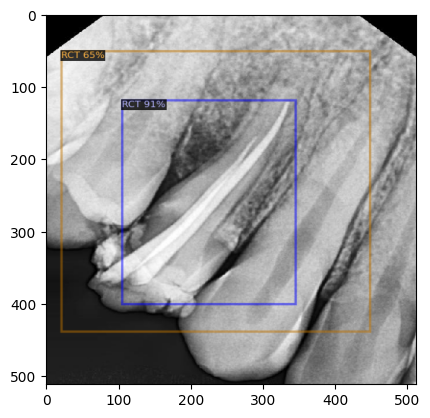



Classes : 
 tensor([8, 8, 8], device='cuda:0')
Scores : 
 tensor([0.9198, 0.6229, 0.6008], device='cuda:0')


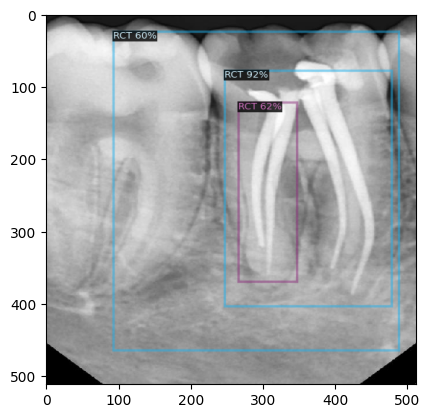



Classes : 
 tensor([5], device='cuda:0')
Scores : 
 tensor([0.6048], device='cuda:0')


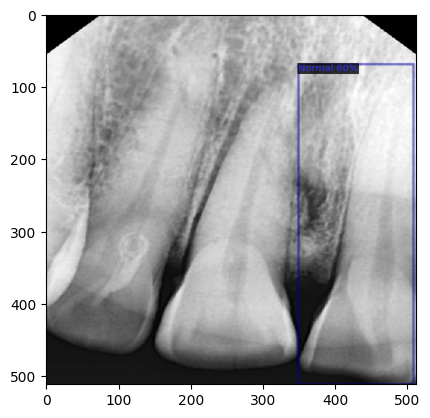



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9571], device='cuda:0')


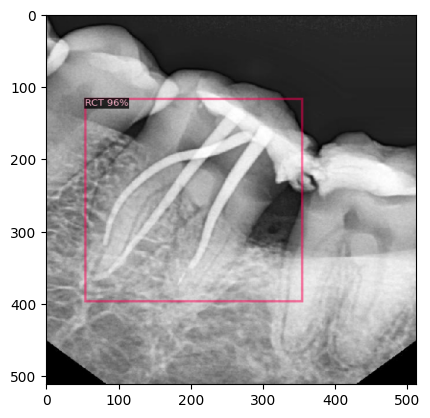



Classes : 
 tensor([8, 9, 5], device='cuda:0')
Scores : 
 tensor([0.7970, 0.6307, 0.6201], device='cuda:0')


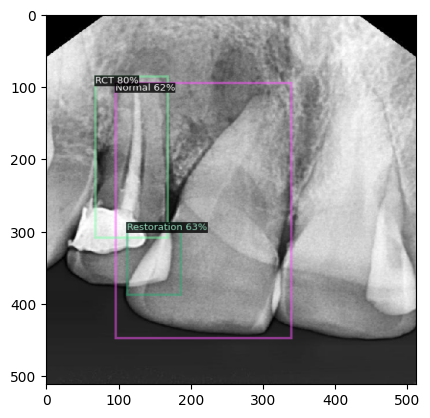



Classes : 
 tensor([8, 5, 8], device='cuda:0')
Scores : 
 tensor([0.9431, 0.7159, 0.7079], device='cuda:0')


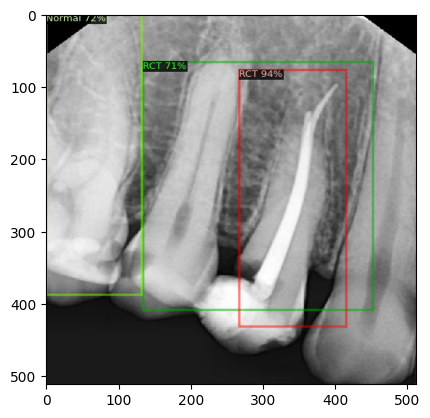



Classes : 
 tensor([8], device='cuda:0')
Scores : 
 tensor([0.9297], device='cuda:0')


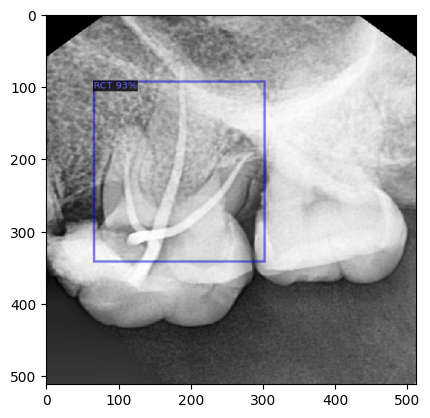



Classes : 
 tensor([5, 5], device='cuda:0')
Scores : 
 tensor([0.6376, 0.6027], device='cuda:0')


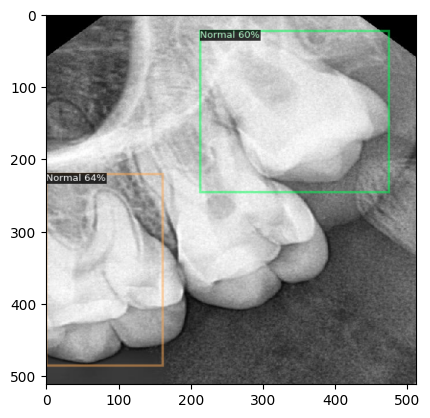



Classes : 
 tensor([8, 8, 9, 9, 8], device='cuda:0')
Scores : 
 tensor([0.9292, 0.8752, 0.8463, 0.6681, 0.6044], device='cuda:0')


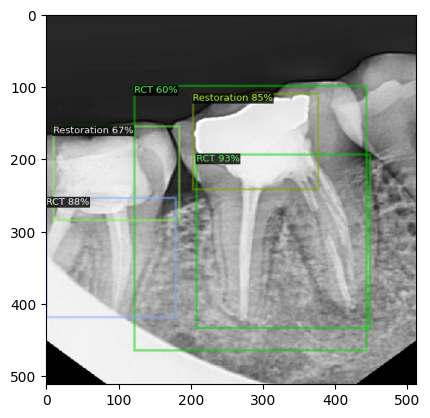

In [29]:
# Using saved model
my_cfg = get_cfg()
my_cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
my_cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6 # Set threshold for this model
my_cfg.MODEL.WEIGHTS = "/kaggle/working/output/model_final.pth"
my_cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10
my_model_detectron2 = DefaultPredictor(my_cfg)


from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob("/kaggle/working/dental-annotation-16/test/*jpg"):
  im = cv2.imread(imageName)
  outputs = my_model_detectron2(im)
  print("Classes : \n", outputs["instances"].pred_classes)
  print("Scores : \n", outputs["instances"].scores)

  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.imshow(out.get_image()[:, :, ::-1])
  plt.show()
  print("\n")